<a href="https://colab.research.google.com/github/kigit2017/SeoulBikes/blob/main/SeoulBikes2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Project Title
%%html
<marquee stle = 'width:100%; color:blue;'><b> <h1 style = "color:SeaGreen; font-family : verdana;"> Seoul Bike Sharing Demand Prediction (Supervised ML)<h1></b></marquee>

# Data Decription
The datset contains weather information (Temperarure, Humidity, Windspeed, Dewpoint, Solar radiation,Snowfall, Rainfall)
The number of bikes rented per hour and date informations are available.

## Attribute Information
- Date : year-month-day
- Rented Bike Count - Count of Bikes rented at each hour
- Hour - Hour of the day
- Temperature - Temperarure in Celcius
- Humidity - %
- Windspeed - m/s
- Visibility - 10m
- Dew Point temperarure - Celsius
- Solar Radiation - MJ/m^2
- Rainfall - mm
- Snowfall - cm
- Seasons - Winter, Spring, Summer, Aututmn
- Holiday - Holiday/no Holiday
- Functional Day - No FUnc(No Functional Hours), Fun(Functional Hours)

## Project Flow Control -
- Loading data and Diagnosing the data
- Data filtering
- EDA of Row data to understand inside correlations
- Feature Selection - We are not use much because of limited features in our data
- Model Building
- Model training
- Model Evaluation and hyper parameters training

# 1. Import Libraries and Data

In [2]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn import preprocessing, linear_model
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.metrics import r2_score, mean_squared_error, accuracy_score
from sklearn.linear_model import LinearRegression

## 1.1 Data Loading

In [3]:
data = pd.read_csv('/content/SeoulBikeData.csv')

In [4]:
%load_ext google.colab.data_table
data

,Date,Rented Bike Count,Hour,Temperature(C),Humidity(%),Wind speed (m/s),Visibility (10m),Dew point temperature(C),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm),Seasons,Holiday,Functioning Day
0,01/12/2017,254,0,-5.2,37,2.2,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,Yes
1,01/12/2017,204,1,-5.5,38,0.8,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,Yes
2,01/12/2017,173,2,-6.0,39,1.0,2000,-17.7,0.0,0.0,0.0,Winter,No Holiday,Yes
3,01/12/2017,107,3,-6.2,40,0.9,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,Yes
4,01/12/2017,78,4,-6.0,36,2.3,2000,-18.6,0.0,0.0,0.0,Winter,No Holiday,Yes
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8755,30/11/2018,1003,19,4.2,34,2.6,1894,-10.3,0.0,0.0,0.0,Autumn,No Holiday,Yes
8756,30/11/2018,764,20,3.4,37,2.3,2000,-9.9,0.0,0.0,0.0,Autumn,No Holiday,Yes
8757,30/11/2018,694,21,2.6,39,0.3,1968,-9.9,0.0,0.0,0.0,Autumn,No Holiday,Yes
8758,30/11/2018,712,22,2.1,41,1.0,1859,-9.8,0.0,0.0,0.0,Autumn,No Holiday,Yes


## 1.1.2 First check the duplicate entries
- Duplicate entries given wrong prediction and also consume unnecessory stroage and consuming time during testing and taining data


In [5]:
print(len(data[data.duplicated()]))

0


- Not Found any duplicated entries inside data

## 1.2 Diagnosing the data

In [6]:
# Custom functions for finding, Dtype, Unique values and null values
def datainfo():
  temp_ps = pd.DataFrame(index = data.columns)
  temp_ps['DataType'] = data.dtypes
  temp_ps['Non-null_values'] = data.count()
  temp_ps['Unique_values'] = data.nunique()
  temp_ps['NaN_Values'] = data.isnull().sum()
  temp_ps['NaN_Values_percentage'] = (temp_ps['NaN_Values']/len(data))*100
  return temp_ps

In [7]:
print(datainfo())

                         DataType  Non-null_values  Unique_values  NaN_Values  \
Date                       object             8760            365           0   
Rented Bike Count           int64             8760           2166           0   
Hour                        int64             8760             24           0   
Temperature(C)            float64             8760            546           0   
Humidity(%)                 int64             8760             90           0   
Wind speed (m/s)          float64             8760             65           0   
Visibility (10m)            int64             8760           1789           0   
Dew point temperature(C)  float64             8760            556           0   
Solar Radiation (MJ/m2)   float64             8760            345           0   
Rainfall(mm)              float64             8760             61           0   
Snowfall (cm)             float64             8760             51           0   
Seasons                    o

### Finding details of the data
- 1. There are 14 features with 8760 rows of data.
- 2. There are 4 categorical columns and 10 numerical columns. Columns 'Date','Seasons','Functioning Day',  are object Data Type
- 3. Columns 'Rented Bike Count','Hour','Humidity','and Visibility(10m) are of int 64 type
- 4. Column 'Temperature (degree celcius), wind speed (m/s), Dew point temperature (degreee celcius), Solar Radiation(MJ/m^2), Rainfall(mm) and Snowfall(cm) are of float64 numerical data type.
- 5.Not any nul values present in any column
6. Unique count: Seasong -4, Holiday-2, Functioning Day-2


In [8]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Rented Bike Count,8760.0,704.602055,644.997468,0.0,191.00,504.50,1065.25,3556.00
Hour,8760.0,11.500000,6.922582,0.0,5.75,11.50,17.25,23.00
Temperature(C),8760.0,12.882922,11.944825,-17.8,3.50,13.70,22.50,39.40
Humidity(%),8760.0,58.226256,20.362413,0.0,42.00,57.00,74.00,98.00
Wind speed (m/s),8760.0,1.724909,1.036300,0.0,0.90,1.50,2.30,7.40
Visibility (10m),8760.0,1436.825799,608.298712,27.0,940.00,1698.00,2000.00,2000.00
Dew point temperature(C),8760.0,4.073813,13.060369,-30.6,-4.70,5.10,14.80,27.20
Solar Radiation (MJ/m2),8760.0,0.569111,0.868746,0.0,0.00,0.01,0.93,3.52
Rainfall(mm),8760.0,0.148687,1.128193,0.0,0.00,0.00,0.00,35.00
Snowfall (cm),8760.0,0.075068,0.436746,0.0,0.00,0.00,0.00,8.80


# 2. Data Filtering

## 2.1 Rented Bike days filtering

In [9]:
# for checking fucntioning and non functioning day,plot (hour VS Rented Bike COunt Graph)

def barplots(x,y,hue):
  plt.figure(figsize = (15,7))
  sns.set_palette('husl')
  sns.barplot(x = x,y = y,hue = hue, data=data)


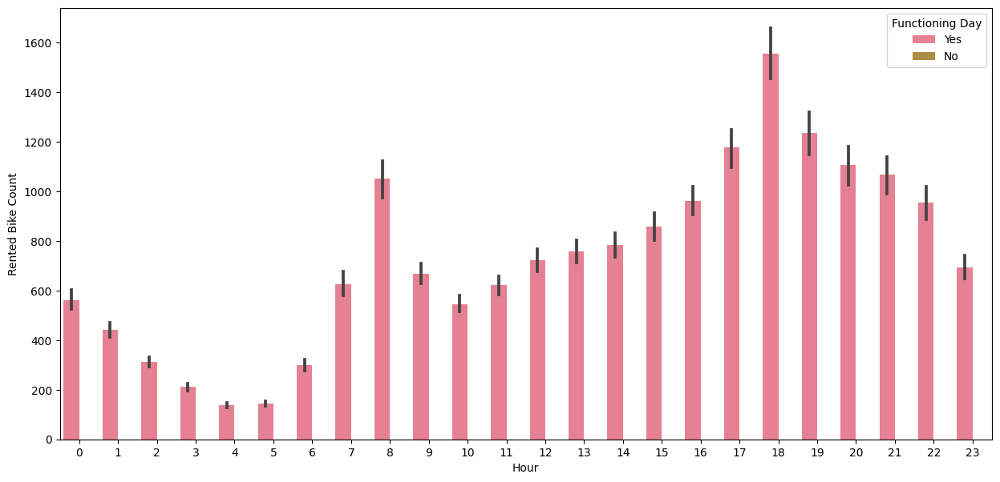

In [10]:
barplots('Hour','Rented Bike Count','Functioning Day')

In [11]:
# Grouping by functioning day and calculating the total Rented Bike Count
data.groupby('Functioning Day').sum()['Rented Bike Count'].sort_values(ascending = False).reset_index()

<ipython-input-11-e6facfbaa73d>:2: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  data.groupby('Functioning Day').sum()['Rented Bike Count'].sort_values(ascending = False).reset_index()


,Functioning Day,Rented Bike Count
0,Yes,6172314
1,No,0


In [12]:
# we will removie non functioning day columns
df = data.drop(data[data['Functioning Day'] == 'No'].index)
df.shape

(8465, 14)

In [13]:
# Due to not unseful in fucntiong day remove the columns
df1 = df.drop(['Functioning Day'], axis = 1)

In [14]:
df1.shape

(8465, 13)

In [15]:
# We will sepearate Date, Month, year from the Date column
# 1st we will convert Date to datecolumn and extra different parts of the date

df1['Date'] = pd.to_datetime(df1['Date'])
df1['Date']

<ipython-input-15-622473c1a190>:4: UserWarning: Parsing dates in DD/MM/YYYY format when dayfirst=False (the default) was specified. This may lead to inconsistently parsed dates! Specify a format to ensure consistent parsing.
  df1['Date'] = pd.to_datetime(df1['Date'])


0      2017-01-12
1      2017-01-12
2      2017-01-12
3      2017-01-12
4      2017-01-12
          ...    
8755   2018-11-30
8756   2018-11-30
8757   2018-11-30
8758   2018-11-30
8759   2018-11-30
Name: Date, Length: 8465, dtype: datetime64[ns]

In [16]:
# seperate day, month, year
df1['Day'] = df1['Date'].dt.day
df1['Month'] = df1['Date'].dt.month
df1['Year'] = df1['Date'].dt.year

In [17]:
df1.head()

,Date,Rented Bike Count,Hour,Temperature(C),Humidity(%),Wind speed (m/s),Visibility (10m),Dew point temperature(C),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm),Seasons,Holiday,Day,Month,Year
0,2017-01-12,254,0,-5.2,37,2.2,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,12,1,2017
1,2017-01-12,204,1,-5.5,38,0.8,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,12,1,2017
2,2017-01-12,173,2,-6.0,39,1.0,2000,-17.7,0.0,0.0,0.0,Winter,No Holiday,12,1,2017
3,2017-01-12,107,3,-6.2,40,0.9,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,12,1,2017
4,2017-01-12,78,4,-6.0,36,2.3,2000,-18.6,0.0,0.0,0.0,Winter,No Holiday,12,1,2017


In [18]:
# drop the date column after extracting the necessory information
df1.drop(columns = ['Date'], inplace = True)

In [19]:
df1.head()

,Rented Bike Count,Hour,Temperature(C),Humidity(%),Wind speed (m/s),Visibility (10m),Dew point temperature(C),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm),Seasons,Holiday,Day,Month,Year
0,254,0,-5.2,37,2.2,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,12,1,2017
1,204,1,-5.5,38,0.8,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,12,1,2017
2,173,2,-6.0,39,1.0,2000,-17.7,0.0,0.0,0.0,Winter,No Holiday,12,1,2017
3,107,3,-6.2,40,0.9,2000,-17.6,0.0,0.0,0.0,Winter,No Holiday,12,1,2017
4,78,4,-6.0,36,2.3,2000,-18.6,0.0,0.0,0.0,Winter,No Holiday,12,1,2017


# 3.1 Exploratory Analysis and Visulization

Let's explore the data by visulizing the distribution of values in some columns of the dataset, and the relationship between "Rented Bike count" and other columns.


## 3.1 Checking Correlation of Data
Correlation is statistical measure that expresses the strength of the relationship between two variables.
The two main types of correlation : <b> positive and negative </b>


<ipython-input-20-a27931301cc7>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  data_corr = df1.corr()


<Axes: >

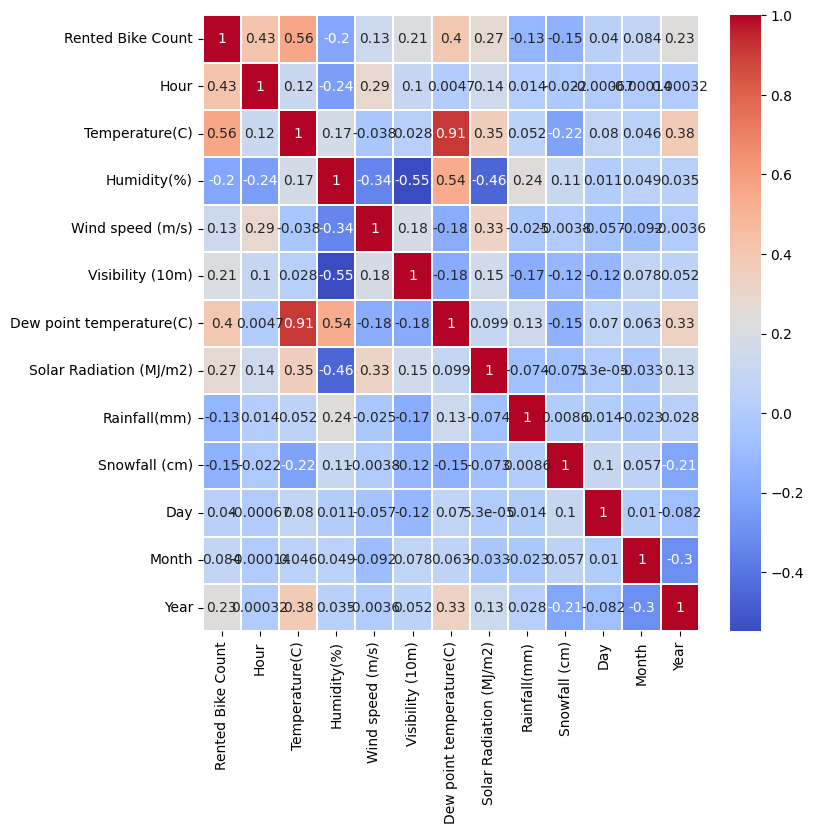

In [20]:
# corr()
data_corr = df1.corr()
plt.figure(figsize = (8,8))

sns.heatmap(data_corr, cmap = 'coolwarm', linewidths = 0.1, annot = True, linecolor = 'White')

In [21]:
df1.drop(columns = ['Dew point temperature(C)'], inplace = True)

In [22]:
df1.shape

(8465, 14)

In [23]:
df1.columns

Index(['Rented Bike Count', 'Hour', 'Temperature(C)', 'Humidity(%)',
       'Wind speed (m/s)', 'Visibility (10m)', 'Solar Radiation (MJ/m2)',
       'Rainfall(mm)', 'Snowfall (cm)', 'Seasons', 'Holiday', 'Day', 'Month',
       'Year'],
      dtype='object')

In [24]:
# seperating numerical and categorical data
numerical_features = [col for col in df1.columns if df1[col].dtype != 'O']
numerical_features


['Rented Bike Count',
 'Hour',
 'Temperature(C)',
 'Humidity(%)',
 'Wind speed (m/s)',
 'Visibility (10m)',
 'Solar Radiation (MJ/m2)',
 'Rainfall(mm)',
 'Snowfall (cm)',
 'Day',
 'Month',
 'Year']

In [25]:
num_data = df1[numerical_features]
num_data

,Rented Bike Count,Hour,Temperature(C),Humidity(%),Wind speed (m/s),Visibility (10m),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm),Day,Month,Year
0,254,0,-5.2,37,2.2,2000,0.0,0.0,0.0,12,1,2017
1,204,1,-5.5,38,0.8,2000,0.0,0.0,0.0,12,1,2017
2,173,2,-6.0,39,1.0,2000,0.0,0.0,0.0,12,1,2017
3,107,3,-6.2,40,0.9,2000,0.0,0.0,0.0,12,1,2017
4,78,4,-6.0,36,2.3,2000,0.0,0.0,0.0,12,1,2017
...,...,...,...,...,...,...,...,...,...,...,...,...
8755,1003,19,4.2,34,2.6,1894,0.0,0.0,0.0,30,11,2018
8756,764,20,3.4,37,2.3,2000,0.0,0.0,0.0,30,11,2018
8757,694,21,2.6,39,0.3,1968,0.0,0.0,0.0,30,11,2018
8758,712,22,2.1,41,1.0,1859,0.0,0.0,0.0,30,11,2018


Density plot to find the increase or derease in rented bike ount.

<ipython-input-26-a178f7802ce1>:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df1[column])
<ipython-input-26-a178f7802ce1>:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df1[column])
<ipython-input-26-a178f7802ce1>:5: UserWarning: 

`distplot` is a deprecated function and will be removed in

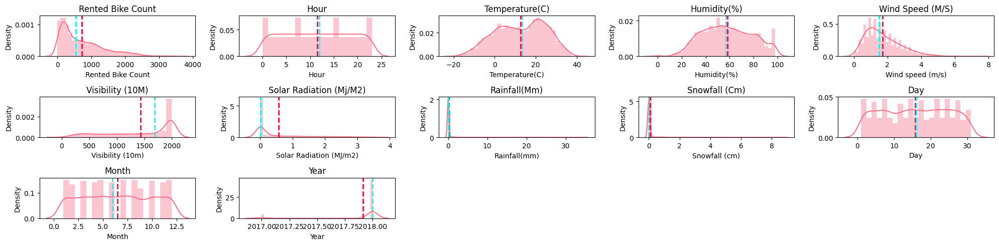

In [26]:
# Plot num data to analysis data distribution
fig = plt.figure(figsize = (20,5))
for index, column in enumerate(numerical_features):
  plt.subplot(3,5,index+1)
  sns.distplot(df1[column])
  feature = df1[column]
  ax = fig.gca()
  ax.axvline(feature.mean(), color = '#ff033e',linestyle = 'dashed',linewidth = 2) # Rose-red color indicate mean of data
  ax.axvline(feature.median(), color = '#00ffff', linestyle = 'dashed', linewidth = 2)# Cyan indicate median of data
  plt.title(f'{column.title()}')
  plt.tight_layout()


In [27]:
df1.agg(['skew','kurtosis']).transpose()

<ipython-input-27-24df6756e64d>:1: FutureWarning: ['Seasons', 'Holiday'] did not aggregate successfully. If any error is raised this will raise in a future version of pandas. Drop these columns/ops to avoid this warning.
  df1.agg(['skew','kurtosis']).transpose()


,skew,kurtosis
Rented Bike Count,1.139700,0.820305
Hour,-0.001261,-1.203446
Temperature(C),-0.174550,-0.889578
Humidity(%),0.068649,-0.812228
Wind speed (m/s),0.894222,0.754256
Visibility (10m),-0.695306,-0.969125
Solar Radiation (MJ/m2),1.510065,1.145102
Rainfall(mm),14.616921,289.963779
Snowfall (cm),8.292830,90.542378
Day,-0.019049,-1.198170


- **Right/Positive skewed distribution**:* Mode < Mdeian < Mean : Rented Bike count, wind speed , Solar Radiation*\

- **No Skew** : *Mean = Median = Mode : Hour, Temperature, Humidity, Rainfall, Snowfall*

- **Left/negative Skewed Distribution** :* Mean < Median < Mode : Visisbility.*

Discrete variable count:4


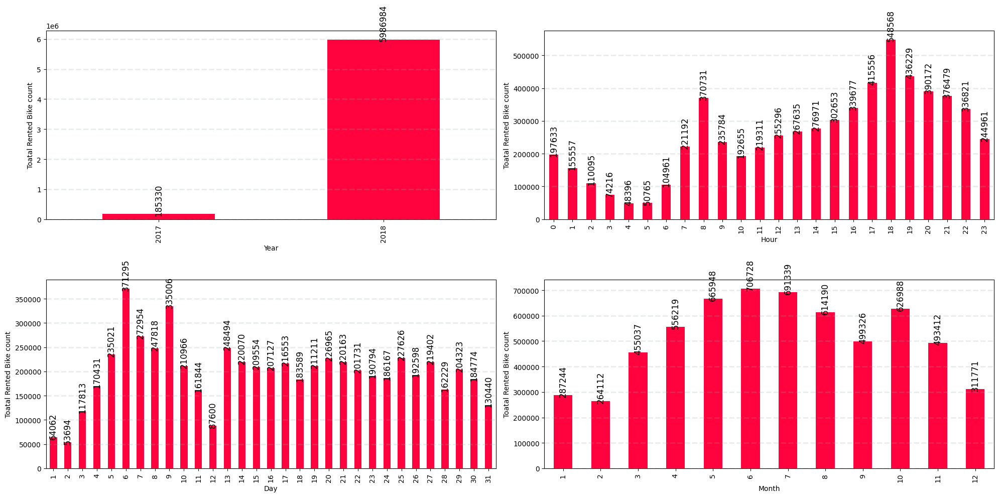

In [28]:
# lets analyse the discrete values by creating histogram to undestand the distribution
num_dicrete_values = [feature for feature in numerical_features if len(df1[feature].unique()) < 32]
num_dicrete_values
print("Discrete variable count:{}".format(len(num_dicrete_values)))

fig = plt.figure(figsize = (20,10))
for index, column in enumerate(num_dicrete_values):
  plt.subplot(2,2,index+1)
  dataset = df1.copy()
  dataset.groupby(feature)['Rented Bike Count'].sum().plot(kind = 'bar', color = '#ff033e')
  feature = df1[column]
  ax = fig.gca()
  plt.ylabel('Toatal Rented Bike count')
  plt.tight_layout()
  plt.grid(color = '#95a5a6', linestyle ='--',linewidth = 2, axis = 'y', alpha = 0.2 )
  for p in ax.patches:
    ax.annotate(round(p.get_height()), (p.get_x() + p.get_width()/2,p.get_height()), ha = 'center', size = 12, rotation = 90) #ha use to write count in center and rotation use to rotate count to 90 degree and make clear vision on graph


Bar plots for features for day,month,hour and year and the rented bike count for the period.
**Year** - Total rented bike count for 2017,2018..(2018 has highest rented bike count)
**Hour**- Rented bike count for each hour (Morning rental pickup hours and evening returns are peak rental hours)
**Day**- Total rented bikes for each day.
**Month**. Total rented bike count for each month(low rentals in Dec,Jan and Feb)

In [29]:
categorical_features = [col for col in df1.columns if df1[col].dtype == 'O']
categorical_features

['Seasons', 'Holiday']

Store categorical data


In [30]:
cat_data = df1[categorical_features]
cat_data

,Seasons,Holiday
0,Winter,No Holiday
1,Winter,No Holiday
2,Winter,No Holiday
3,Winter,No Holiday
4,Winter,No Holiday
...,...,...
8755,Autumn,No Holiday
8756,Autumn,No Holiday
8757,Autumn,No Holiday
8758,Autumn,No Holiday


In [31]:
# Unique number of categorical featurses
for feature in categorical_features:
  print('The feature is {} and number of categries are {}'.format(feature, len(data[feature].unique())))

The feature is Seasons and number of categries are 4
The feature is Holiday and number of categries are 2


In [32]:
# gruping by seasins and calculating the total rented bike count
df1.groupby('Seasons').sum()['Rented Bike Count'].sort_values(ascending = False).reset_index()

<ipython-input-32-f6d0c2ca0453>:2: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df1.groupby('Seasons').sum()['Rented Bike Count'].sort_values(ascending = False).reset_index()


,Seasons,Rented Bike Count
0,Summer,2283234
1,Autumn,1790002
2,Spring,1611909
3,Winter,487169


In [33]:
# Group hoiliday and no holiday and count the rented bike count

df1.groupby('Holiday').sum()['Rented Bike Count'].sort_values(ascending = False).reset_index()

<ipython-input-33-6e3b9daaea2a>:3: FutureWarning: The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  df1.groupby('Holiday').sum()['Rented Bike Count'].sort_values(ascending = False).reset_index()


,Holiday,Rented Bike Count
0,No Holiday,5956419
1,Holiday,215895


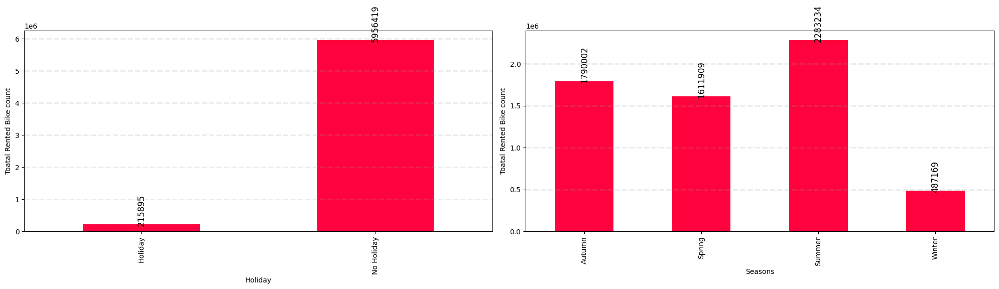

In [34]:
# Find out the relationship between categorical variable and dependent features Renetd Bike count
fig = plt.figure(figsize = (20,10))
for index, column in enumerate(cat_data):
  plt.subplot(2,2,index+1)
  dataset = df1.copy()
  dataset.groupby(feature)['Rented Bike Count'].sum().plot(kind = 'bar', color = '#ff033e')
  feature = df1[column]
  ax = fig.gca()
  plt.ylabel('Toatal Rented Bike count')
  plt.tight_layout()
  plt.grid(color = '#95a5a6', linestyle ='--',linewidth = 2, axis = 'y', alpha = 0.2 )
  for p in ax.patches:
    ax.annotate(round(p.get_height()), (p.get_x() + p.get_width()/2,p.get_height()), ha = 'center', size = 12, rotation = 90) #ha use to write count in center and rotation use to rotate count to 90 degree and make clear vision on graph


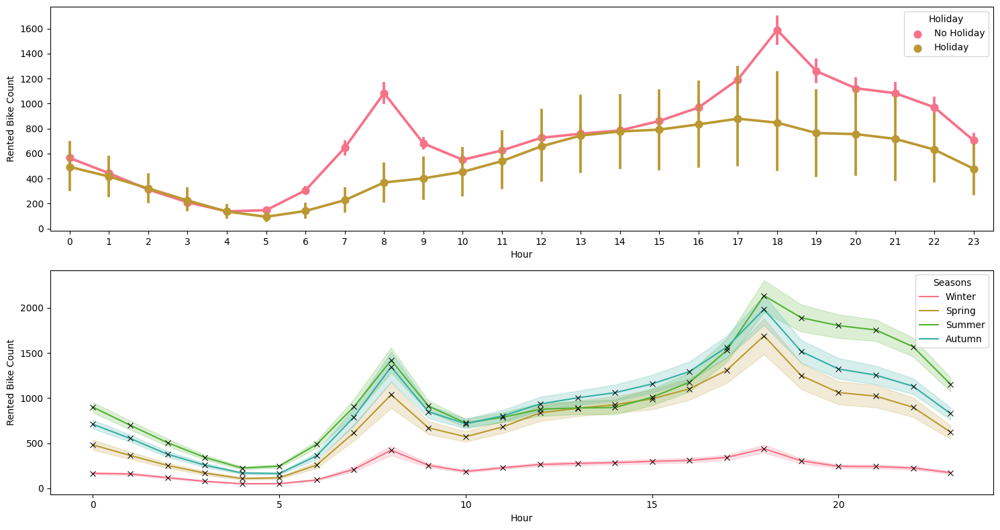

In [35]:
fig, axs = plt.subplots(nrows = 2, ncols = 1,figsize = (15,8), dpi = 100)
sns.pointplot(data = df1, x = "Hour", y = "Rented Bike Count", ax = axs[0],
              hue = "Holiday")
sns.lineplot(data =df1, x = "Hour", y = "Rented Bike Count", ax = axs[1],
             hue = 'Seasons', marker = 'x', markeredgecolor = "black")
plt.tight_layout()

### Encode Categorical data into one-hot vectors
### Indentify inputs and target
### Scale values in numeric columns to a (0,1) range
### Spit the dataset into training and validation sets.

###
- Encoder encoded the categorical data into numbers
- oh_df : One hot encoder
- le_df: LabelEncoder Data


Changes categorical values to numerical(1234) for Day,month,year using Label encoder
``
# This is formatted as code
```



In [36]:
# We will apply LabelEncoder
le_df = df1.apply(LabelEncoder(). fit_transform)
le_df

,Rented Bike Count,Hour,Temperature(C),Humidity(%),Wind speed (m/s),Visibility (10m),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm),Seasons,Holiday,Day,Month,Year
0,252,0,111,28,22,1779,0,0,0,3,1,11,0,0
1,202,1,108,29,8,1779,0,0,0,3,1,11,0,0
2,171,2,103,30,10,1779,0,0,0,3,1,11,0,0
3,105,3,101,31,9,1779,0,0,0,3,1,11,0,0
4,76,4,103,27,23,1779,0,0,0,3,1,11,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8755,990,19,205,25,26,1673,0,0,0,0,1,29,10,1
8756,754,20,197,28,23,1779,0,0,0,0,1,29,10,1
8757,685,21,189,30,3,1747,0,0,0,0,1,29,10,1
8758,703,22,184,32,10,1639,0,0,0,0,1,29,10,1


In [37]:
# Checking Seasons Column Data
df1.groupby('Seasons').count() # for checking raw data

,Rented Bike Count,Hour,Temperature(C),Humidity(%),Wind speed (m/s),Visibility (10m),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm),Holiday,Day,Month,Year
Seasons,,,,,,,,,,,,,
Autumn,1937,1937,1937,1937,1937,1937,1937,1937,1937,1937,1937,1937,1937
Spring,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160
Summer,2208,2208,2208,2208,2208,2208,2208,2208,2208,2208,2208,2208,2208
Winter,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160


In [38]:
le_df.groupby('Seasons').count() # Seasons convert to numerical after apply transformation on data

,Rented Bike Count,Hour,Temperature(C),Humidity(%),Wind speed (m/s),Visibility (10m),Solar Radiation (MJ/m2),Rainfall(mm),Snowfall (cm),Holiday,Day,Month,Year
Seasons,,,,,,,,,,,,,
0,1937,1937,1937,1937,1937,1937,1937,1937,1937,1937,1937,1937,1937
1,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160
2,2208,2208,2208,2208,2208,2208,2208,2208,2208,2208,2208,2208,2208
3,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160,2160


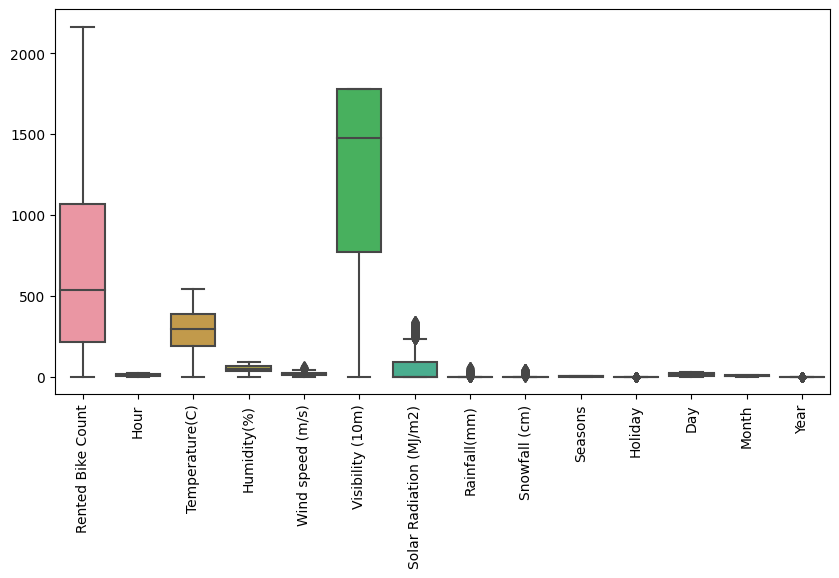

In [39]:
# checking for outliers
plt.figure(figsize = (10,5)) # for define chart size
plt.xticks(rotation = 90)
sns.boxplot(data = le_df)
plt.show()

Box plots for each feature - to find outliers, reduce outliers, median,inner and outer quartile,percentile

## **Humidity Box Plot**
**Humidity box plot lower(25%)-42.0	median-57.0	upper(75%)-74.0	max-98.0**
**NO outliers present in Humity data**

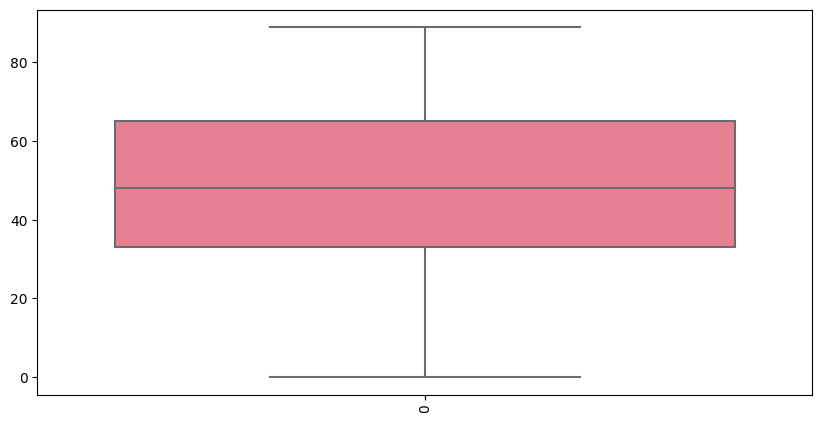

In [40]:
# checking for outliers
plt.figure(figsize = (10,5)) # for define chart size
plt.xticks(rotation = 90)

sns.boxplot(data = le_df['Humidity(%)'])

plt.show()

 **Box Plot Solar Radiation  distribution- **
**Outliers are present. To remove outliers transformed data to Monthly Mean of Radiation.**
**Min 34.52	Lower Quartile- 57.43	**
**median - 58.54**
**Upper(75) quartile 59.63	**
**Max 77.73**



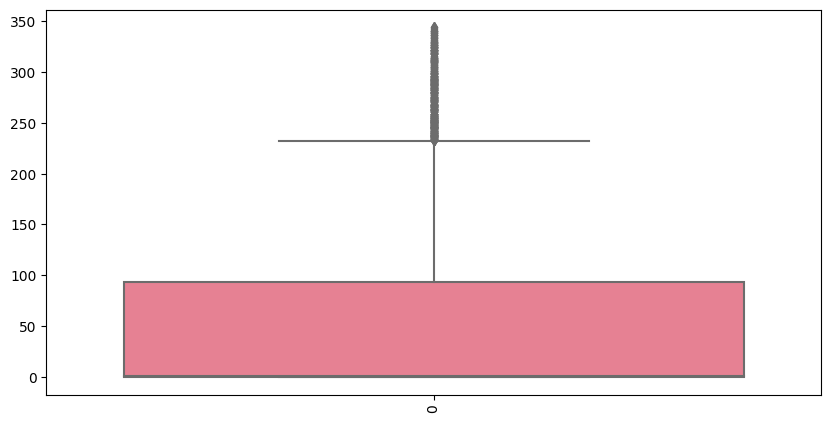

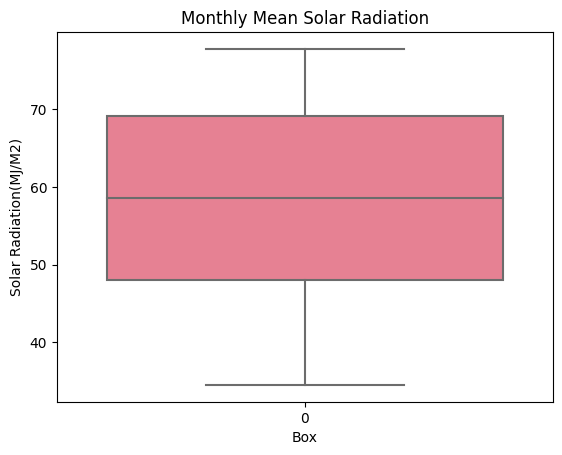

In [41]:
# checking for outliers
plt.figure(figsize = (10,5)) # for define chart size
plt.xticks(rotation = 90)
data_2 = le_df.groupby('Month').mean()['Solar Radiation (MJ/m2)']
#data_2
#sns.boxplot(data = le_df['Solar Radiation (MJ/m2)'])
sns.boxplot(data = le_df['Solar Radiation (MJ/m2)'])
plt.show()
sns.boxplot(data = data_2)
plt.title("Monthly Mean Solar Radiation")
plt.xlabel("Box")
plt.ylabel("Solar Radiation(MJ/M2)")
plt.show()
#data_2.median()
#data_2.min()
#data_2.max()
#data_2.quantile(interpolation='lower')

# **Box Plot for Temperature - No outliers present**
**Min=-17.8**
**Lower quartile = 3.5**
**Median = 13.7**
**Upper Quartile = 22.**5
**Maximum  = 39.4**


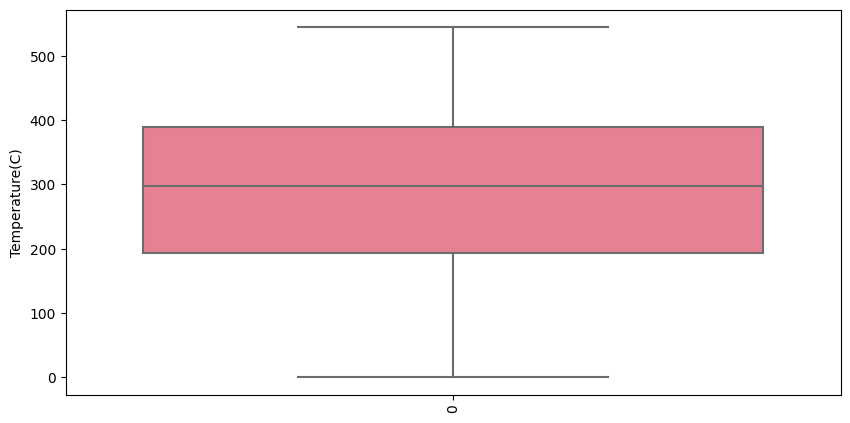

In [42]:
# checking for outliers
plt.figure(figsize = (10,5)) # for define chart size
plt.xticks(rotation = 90)
sns.boxplot(data = le_df['Temperature(C)'])
plt.title = 'Temperature Box Plot'
plt.ylabel('Temperature(C)')
plt.show()

# **Boxplot for Wind Speed**
**Outier in boxplot for Wind Speed**..**Transformed to monthly mean for plotting Wind speed to remove outliers.**
**Min = 14.88**
**Lower Quartile=16.75**
**Median=16.94**
**Upper Quartile= 17.13**
**Maximum=19.36**

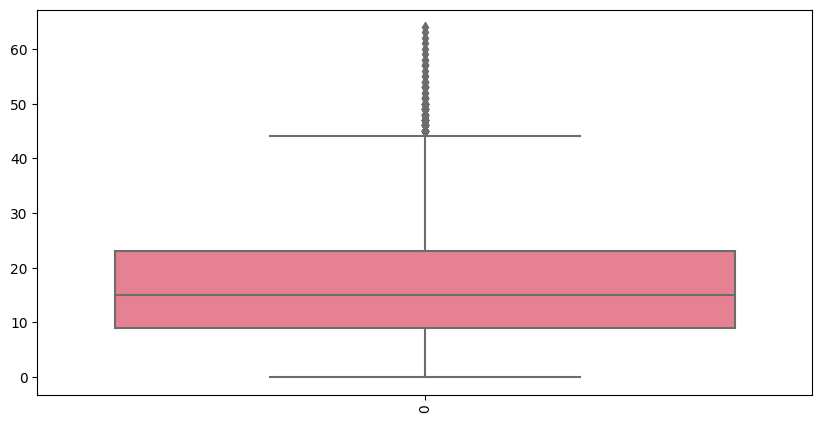

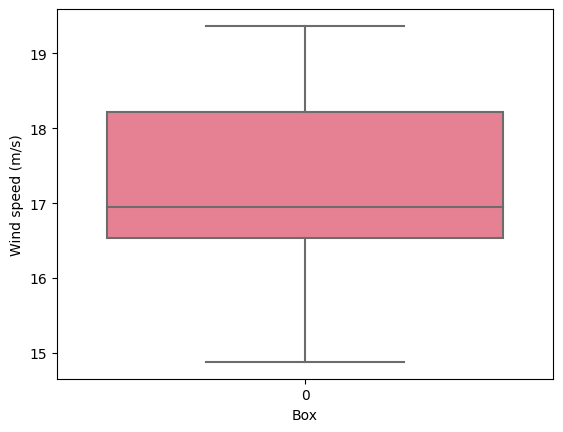

In [43]:
# checking for outliers
plt.figure(figsize = (10,5)) # for define chart size
plt.xticks(rotation = 90)
plt.title="Wind Speed"
sns.boxplot(data = le_df['Wind speed (m/s)'])
plt.show()
data_wind= le_df.groupby('Month').mean()['Wind speed (m/s)']
sns.boxplot(data = data_wind)
plt.xlabel("Box")
plt.ylabel('Wind speed (m/s)')
plt.show()
#data_wind.quantile(interpolation='higher')

# **Box plot for Visibility**
**No outliers in Visibility data.**
**minimum = 27.0 **
**Lower Quartile = 940**
**Upper Quartile = 2000**
**Median = 1698**
**Maximum = 2000**


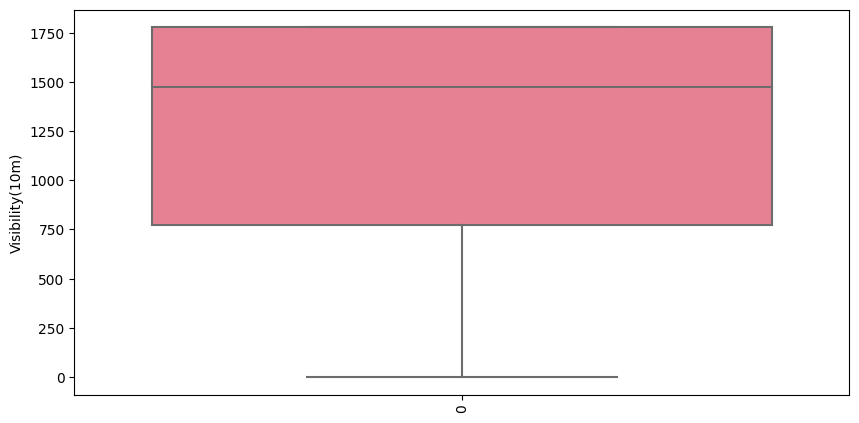

In [44]:
# checking for outliers
plt.figure(figsize = (10,5)) # for define chart size
plt.xticks(rotation = 90)
sns.boxplot(data = le_df['Visibility (10m)'])
plt.ylabel("Visibility(10m)")
plt.show()

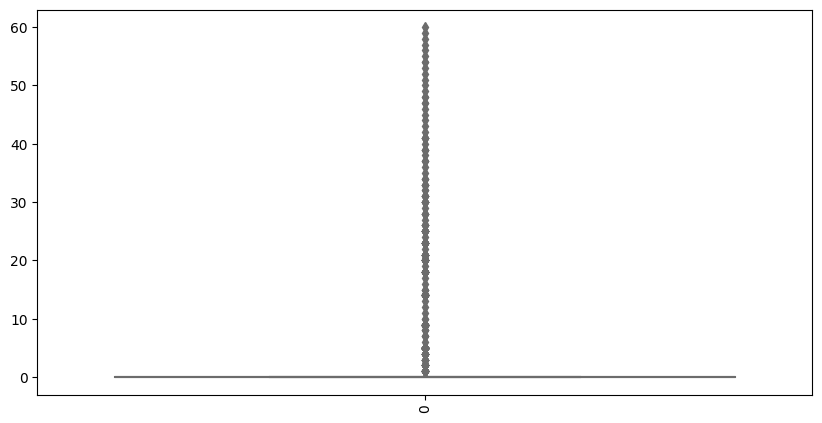

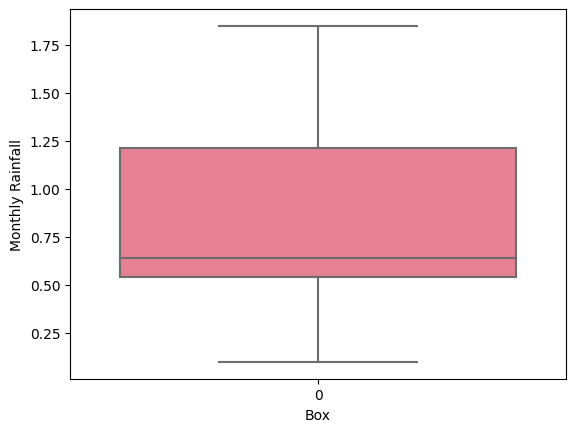

In [45]:
# checking for outliers
plt.figure(figsize = (10,5)) # for define chart size
plt.xticks(rotation = 90)

sns.boxplot(data = (le_df['Rainfall(mm)']))
plt.show()
data_2 = le_df.groupby('Month').mean()['Rainfall(mm)']
sns.boxplot(data = data_2)
#plt.title("Monthly Rainfall")
plt.xlabel("Box")
plt.ylabel("Monthly Rainfall")
plt.show()

**Box plot for Monthly Rainfall** **Outliers are removed**
Lower = .6
Median = .7
Upper quartile = 1.20


Box Plot for Rented Bike Count

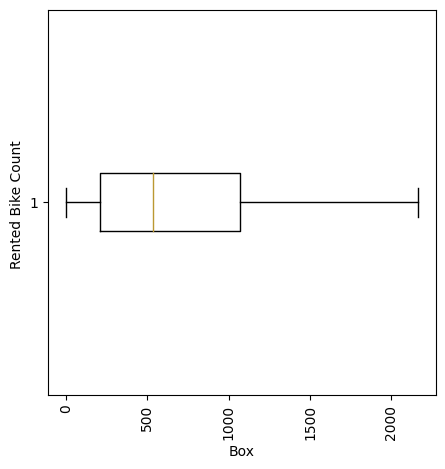

In [46]:
# checking for outliers
plt.figure(figsize = (5,5)) # for define chart size
plt.xticks(rotation = 90)
plt.boxplot(le_df['Rented Bike Count'], vert = False)
plt.xlabel("Box")
plt.ylabel("Rented Bike Count ")
plt.show()

# Transformation ->
The transformation means if we have larger values and our data is  ot performing well then we have certian transformation by whihc we can transform our data and bring it to it's lower form between range 0 to 1.
## Square Root : -
The square root method is typically used when your data is moderately skewed. Now using the square root(e.g sqrt(x)) is a transformation that has a moderate effect on distribution. It is generally used to reduce right sckewed data. FInally, the square root can be applied on zero values and is most common used on counted data.
values y ->  sqrt(y)

## Log Transformation : -
The logarithmic is a strong that has a major effect on distribution shape. This technique is, as the square root method, oftenly used for reducing right sckewness. Worth nothing , however, is that it can not be applied to zero or negative values.
y to log(y)

## Cube root transformation :-
It involves converting x to x^(1/3) .This is a fairly strong transformation with a substantial effect on distribution shape. But it weaker than the logarithm . It can be applied to negative and zero values too. Negatively skewed data also

y to y^1/3


<ipython-input-47-de2b44343bb8>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot((le_df['Rented Bike Count']), ax = axes[0], color = 'brown').set_title("Input Data")
<ipython-input-47-de2b44343bb8>:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(np.log1p(le_df['Rented Bike Count'] + 0.00000001)

Text(0.5, 1.0, 'curplp')

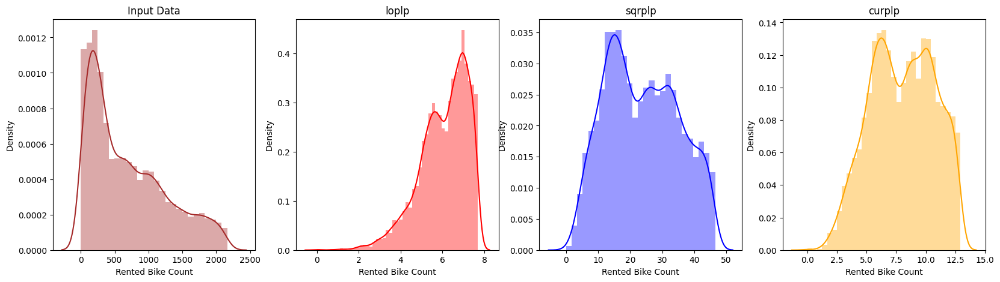

In [47]:
# Applying different transformation technique and checking data distribution
fig , axes = plt.subplots(1,4, figsize = (20,5))
sns.distplot((le_df['Rented Bike Count']), ax = axes[0], color = 'brown').set_title("Input Data")
sns.distplot(np.log1p(le_df['Rented Bike Count'] + 0.00000001), ax = axes[1], color = 'red').set_title('loplp')
sns.distplot(np.sqrt(le_df['Rented Bike Count'] + 0.00000001), ax = axes[2], color = 'blue').set_title('sqrplp')
sns.distplot(np.cbrt(le_df['Rented Bike Count'] + 0.00000001), ax = axes[3], color = 'orange').set_title('curplp')

Sqrt transformation is the best choice for Rented bike count because it is more normalized.

In [48]:
import scipy.stats as stats

In [49]:
def plotvariable (df, variable):
  plt.figure(figsize = (10,5))
  plt.subplot(1,2,1) # means 1 row, 2 column ans 1stplot
  df[variable].hist(bins=30)

  ## QQ plot
  plt.subplot(1,2,2)
  stats.probplot(df[variable], dist = 'norm', plot = plt)
  plt.show()

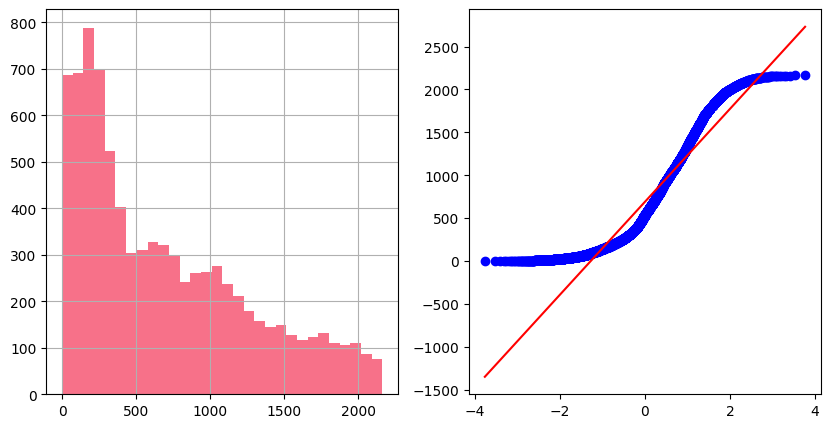

In [50]:
plotvariable(le_df, 'Rented Bike Count')

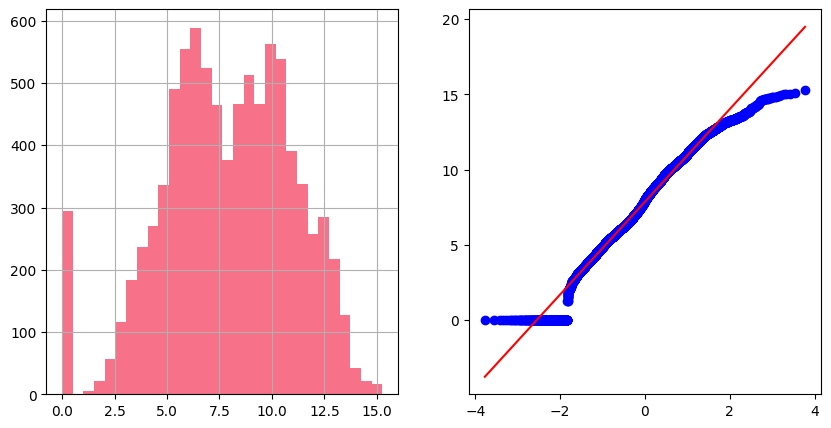

In [51]:
data['RBC_qb'] = np.cbrt(data['Rented Bike Count'])
plotvariable(data, "RBC_qb")

Find Cube root,log and sqrt transformation for wind speed,temperature,

<ipython-input-52-28e375a76441>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot((le_df['Wind speed (m/s)']), ax = axes[0], color = 'brown').set_title("Input Data")
<ipython-input-52-28e375a76441>:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(np.log1p(le_df['Wind speed (m/s)'] + 0.00000001), 

Text(0.5, 1.0, 'curplp')

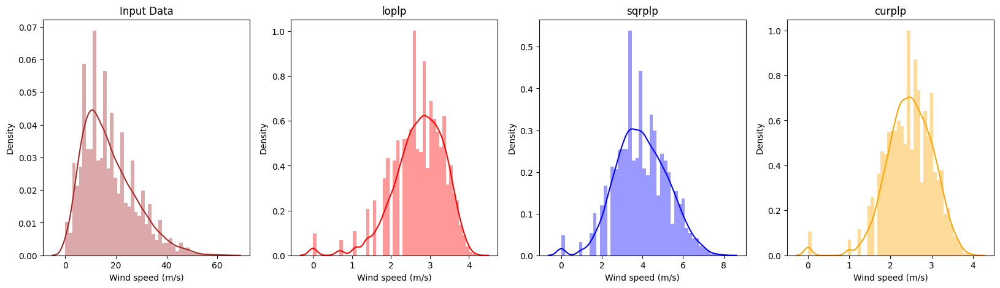

In [52]:
# Applying different transformation technique and checking data distribution
fig , axes = plt.subplots(1,4, figsize = (20,5))
sns.distplot((le_df['Wind speed (m/s)']), ax = axes[0], color = 'brown').set_title("Input Data")
sns.distplot(np.log1p(le_df['Wind speed (m/s)'] + 0.00000001), ax = axes[1], color = 'red').set_title('loplp')
sns.distplot(np.sqrt(le_df['Wind speed (m/s)'] + 0.00000001), ax = axes[2], color = 'blue').set_title('sqrplp')
sns.distplot(np.cbrt(le_df['Wind speed (m/s)'] + 0.00000001), ax = axes[3], color = 'orange').set_title('curplp')

Wind Speed **sqrt** function has normaized curve and can be used for transformation pf data

<ipython-input-53-c88ea5a09ddd>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot((le_df['Temperature(C)']), ax = axes[0], color = 'brown').set_title("Input Data")
<ipython-input-53-c88ea5a09ddd>:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(np.log1p(le_df['Temperature(C)'] + 0.00000001), ax =

Text(0.5, 1.0, 'curplp')

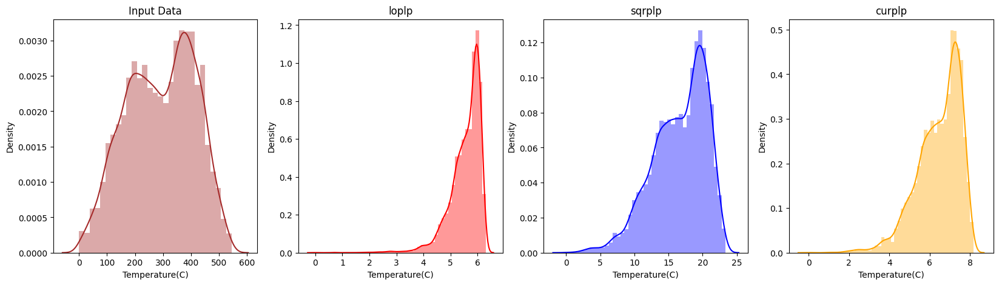

In [53]:
# Applying different transformation technique and checking data distribution
fig , axes = plt.subplots(1,4, figsize = (20,5))
sns.distplot((le_df['Temperature(C)']), ax = axes[0], color = 'brown').set_title("Input Data")
sns.distplot(np.log1p(le_df['Temperature(C)'] + 0.00000001), ax = axes[1], color = 'red').set_title('loplp')
sns.distplot(np.sqrt(le_df['Temperature(C)'] + 0.00000001), ax = axes[2], color = 'blue').set_title('sqrplp')
sns.distplot(np.cbrt(le_df['Temperature(C)'] + 0.00000001), ax = axes[3], color = 'orange').set_title('curplp')

<ipython-input-54-16c6ba3ec3f4>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot((le_df['Rainfall(mm)']), ax = axes[0], color = 'brown').set_title("Input Data")
<ipython-input-54-16c6ba3ec3f4>:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(np.log1p(le_df['Rainfall(mm)'] + 0.00000001), ax = axe

Text(0.5, 1.0, 'curplp')

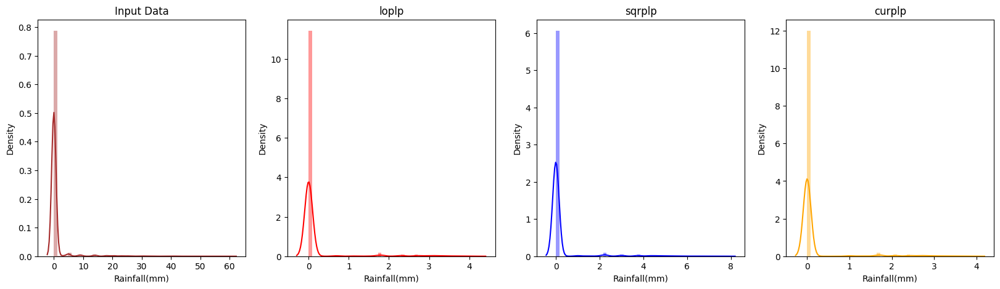

In [54]:
# Applying different transformation technique and checking data distribution
fig , axes = plt.subplots(1,4, figsize = (20,5))
sns.distplot((le_df['Rainfall(mm)']), ax = axes[0], color = 'brown').set_title("Input Data")
sns.distplot(np.log1p(le_df['Rainfall(mm)'] + 0.00000001), ax = axes[1], color = 'red').set_title('loplp')
sns.distplot(np.sqrt(le_df['Rainfall(mm)'] + 0.00000001), ax = axes[2], color = 'blue').set_title('sqrplp')
sns.distplot(np.cbrt(le_df['Rainfall(mm)'] + 0.00000001), ax = axes[3], color = 'orange').set_title('curplp')

<ipython-input-55-912fc5039e99>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot((le_df['Visibility (10m)']), ax = axes[0], color = 'brown').set_title("Input Data")
<ipython-input-55-912fc5039e99>:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(np.log1p(le_df['Visibility (10m)'] + 0.00000001), 

Text(0.5, 1.0, 'curplp')

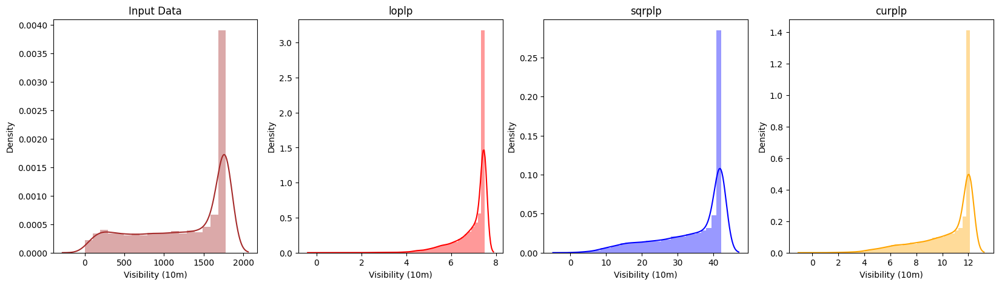

In [55]:
# Applying different transformation technique and checking data distribution
fig , axes = plt.subplots(1,4, figsize = (20,5))
sns.distplot((le_df['Visibility (10m)']), ax = axes[0], color = 'brown').set_title("Input Data")
sns.distplot(np.log1p(le_df['Visibility (10m)'] + 0.00000001), ax = axes[1], color = 'red').set_title('loplp')
sns.distplot(np.sqrt(le_df['Visibility (10m)'] + 0.00000001), ax = axes[2], color = 'blue').set_title('sqrplp')
sns.distplot(np.cbrt(le_df['Visibility (10m)'] + 0.00000001), ax = axes[3], color = 'orange').set_title('curplp')

Humidity-'Humidity(%)'

<ipython-input-56-f1441df0ed0e>:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot((le_df['Humidity(%)']), ax = axes[0], color = 'brown').set_title("Input Data")
<ipython-input-56-f1441df0ed0e>:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(np.log1p(le_df['Humidity(%)'] + 0.00000001), ax = axes[

Text(0.5, 1.0, 'curplp')

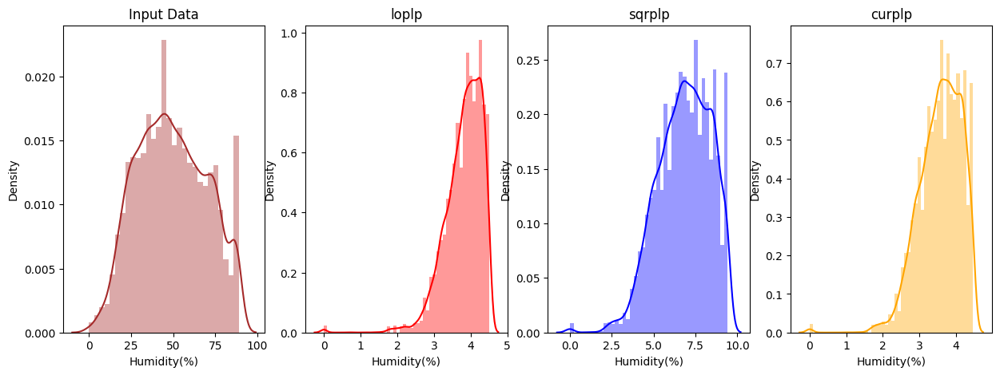

In [56]:
# Applying different transformation technique and checking data distribution
fig , axes = plt.subplots(1,4, figsize = (15,5))
sns.distplot((le_df['Humidity(%)']), ax = axes[0], color = 'brown').set_title("Input Data")
sns.distplot(np.log1p(le_df['Humidity(%)'] + 0.00000001), ax = axes[1], color = 'red').set_title('loplp')
sns.distplot(np.sqrt(le_df['Humidity(%)'] + 0.00000001), ax = axes[2], color = 'blue').set_title('sqrplp')
sns.distplot(np.cbrt(le_df['Humidity(%)'] + 0.00000001), ax = axes[3], color = 'orange').set_title('curplp')

### Indentifying the inputs columns from the dataset

In [57]:
X = le_df.drop('Rented Bike Count',axis = 1)
y = le_df['Rented Bike Count']

In [58]:
X.shape

(8465, 13)

In [59]:
y.shape

(8465,)

In [60]:
X_train,X_test,y_train,y_test =train_test_split(X,y, test_size = 0.2, random_state = 42)
print(X_train.shape, X_test.shape)
print(y_train.shape,y_test.shape)

(6772, 13) (1693, 13)
(6772,) (1693,)


In [61]:
model1 = LinearRegression()

In [62]:
model1_fitted = model1.fit(X_train, y_train)

In [63]:
y_pred = model1_fitted.predict(X_test)

In [64]:
y_pred

array([1473.96186703, 1004.00472145, 1288.97327753, ...,   60.23937601,
        955.41565984, 1260.94400406])

In [65]:
score1 = model1_fitted.score(X_test,y_test)

In [66]:
score1

0.5992307630988626

In [67]:
from sklearn.preprocessing import RobustScaler
from sklearn.metrics import mean_squared_error
def predict(ml_model, X,y):
  X_train,X_test,y_train,y_test = train_test_split(X,y,test_size = 0.2, random_state = 10)
  rob = RobustScaler()

  X_train = rob.fit_transform(X_train)
  X_test = rob.transform(X_test)

  model = ml_model.fit(X_train,y_train)
  y_pred = model.predict(X_test)
  print(f'R^2 is {model.score(X_test, y_test)}\n Adj R^2 is {1-(1-model.score(X_test,y_test))*(len(y_test)-1)/(len(y_test)-X_test.shape[1]-1)} \n RMSE is : {mean_squared_error(y_test,y_pred, squared = False)}')


In [68]:
predict(LinearRegression(), X,y)

R^2 is 0.586976922570936
 Adj R^2 is 0.5837790071411696 
 RMSE is : 372.0340480671815
